# PyTorch Basics


In [ ]:
## Standard libraries
import os
import math
import numpy as np
import time
import gdown

## Imports for plotting
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'pdf') # For export
from matplotlib.colors import to_rgba
import seaborn as sns
sns.set()

## Progress bar
from tqdm.notebook import tqdm

from typing import Any, Callable, List, Optional, Tuple, Dict


<ipython-input-1-546a33fc3894>:12: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('svg', 'pdf') # For export


Importing PyTorch. The package is called `torch`, based on its original framework [Torch](http://torch.ch/).

In [ ]:
# Import the torch library
import torch
print(torch.__version__)

2.3.0+cu121


As in every machine learning framework, PyTorch provides functions that are stochastic like generating random numbers. However, a very good practice is to setup your code to be reproducible with the exact same random numbers. This is why we set a seed below.

In [ ]:
torch.manual_seed(42) # Setting the seed

# Tensors

Tensors are the PyTorch equivalent to Numpy arrays. A `torch.Tensor` is a multi-dimensional matrix containing elements of a single data type.


## Initialization

Different ways of creating a tensor: There are many possible options, the simplest one is to call `torch.Tensor` passing the desired shape as input argument:

In [ ]:
x = torch.Tensor(2,3)
print(x)
print(f"Shape of the Tensor: {x.shape}")

tensor([[7.4937e+31, 1.3367e+10, 7.3387e+28],
        [3.3594e-12, 1.7564e+25, 2.9172e+32]])
Shape of the Tensor: torch.Size([2, 3])


The function `torch.Tensor` allocates memory for the desired tensor, but reuses any values that have already been in the memory. To directly assign values to the tensor during initialization, there are many alternatives including:

* `torch.zeros`: Creates a tensor filled with zeros - [[Link](https://pytorch.org/docs/stable/generated/torch.zeros.html)]

* `torch.ones`: Creates a tensor filled with ones - [[Link](https://pytorch.org/docs/stable/generated/torch.ones.html)]

* `torch.rand`: Creates a tensor with random numbers from a uniform distribution on the interval $[0,1)$ - [[Link](https://pytorch.org/docs/stable/generated/torch.rand.html)]

* `torch.randn`: Creates a tensor with random values sampled from a normal distribution with mean 0 and variance 1, that is $out_i \sim \mathcal{N}(0,1)$  - [[Link](https://pytorch.org/docs/stable/generated/torch.randn.html)]

* `torch.arange`: Creates a tensor containing the values $N,N+1,N+2,...,M$ - [[Link](https://pytorch.org/docs/stable/generated/torch.arange.html)]

* `torch.empty`: Creates a tensor of a specified shape without initializing its elements - [[Link](https://pytorch.org/docs/stable/generated/torch.empty.html)]

* `torch.Tensor` (input list): Creates a tensor from the list elements you provide

In [ ]:
# Create a tensor from a (nested) list
x = torch.Tensor([[1, 2], [3, 4]])
print(x)

tensor([[1., 2.],
        [3., 4.]])


In [ ]:
# Create a tensor with random values between 0 and 1 with the shape [2, 3, 4]
x = torch.rand(2, 3, 4)
print(x)

tensor([[[0.8823, 0.9150, 0.3829, 0.9593],
         [0.3904, 0.6009, 0.2566, 0.7936],
         [0.9408, 0.1332, 0.9346, 0.5936]],

        [[0.8694, 0.5677, 0.7411, 0.4294],
         [0.8854, 0.5739, 0.2666, 0.6274],
         [0.2696, 0.4414, 0.2969, 0.8317]]])


In [ ]:
x = torch.randn(2,3,4)
print(x)

tensor([[[ 0.3559, -0.6866, -0.4934,  0.2415],
         [-1.1109,  0.0915, -2.3169, -0.2168],
         [-0.9138, -0.6581,  0.0780,  0.5258]],

        [[-0.4880,  1.1914, -0.8140, -0.7360],
         [-1.4032,  0.0360, -0.0635,  0.6756],
         [-0.0978,  1.8446, -1.1845,  1.3835]]])


Shape of a tensor can be obtained in the same way as in numpy (`x.shape`), or using the `.size` method:

In [ ]:
shape = x.shape
print("Shape:", x.shape)

size = x.size()
print("Size:", size)

dim1, dim2, dim3 = x.size()
print("Size:", dim1, dim2, dim3)

Shape: torch.Size([2, 3, 4])
Size: torch.Size([2, 3, 4])
Size: 2 3 4


In [ ]:
# Construct a 2x3 matrix, uninitialized
x = torch.empty(2, 3)
print(x)

tensor([[0., 0., 0.],
        [0., 0., 0.]])


Tensor with zeros and ones

In [ ]:
# Create a matrix of all zeros
x = torch.zeros(2, 3)
print("Matrix of zeros")
print(x)

# Create a matrix of all zeros and explicitly set data type to be long int
x = torch.zeros(2, 3, dtype=torch.long)
print("\nMatrix of zeros typecasted to long")
print(x)

x = torch.ones(2, 3, dtype=torch.long)
print("\nMatrix of ones typecasted to long")
print(x)

Matrix of zeros
tensor([[0., 0., 0.],
        [0., 0., 0.]])

Matrix of zeros typecasted to long
tensor([[0, 0, 0],
        [0, 0, 0]])

Matrix of ones typecasted to long
tensor([[1, 1, 1],
        [1, 1, 1]])


#### Tensor to Numpy, and Numpy to Tensor

Tensors can be converted to numpy arrays, and numpy arrays back to tensors. To transform a numpy array into a tensor, we can use the function `torch.from_numpy`:

In [ ]:
np_arr = np.array([[1, 2], [3, 4]])
tensor = torch.from_numpy(np_arr)

print("Numpy array:", np_arr)
print("PyTorch tensor:", tensor)

Numpy array: [[1 2]
 [3 4]]
PyTorch tensor: tensor([[1, 2],
        [3, 4]])


To transform a PyTorch tensor back to a numpy array, we can use the function `.numpy()` on tensors:

In [ ]:
tensor = torch.arange(4)
np_arr = tensor.numpy()

print("PyTorch tensor:", tensor)
print("Numpy array:", np_arr)

PyTorch tensor: tensor([0, 1, 2, 3])
Numpy array: [0 1 2 3]


# Operations with Tensors
Most operations that exist in numpy, also exist in PyTorch. A full list of operations can be found in the [PyTorch documentation](https://pytorch.org/docs/stable/tensors.html#).

The simplest operation is to add two tensors:

In [ ]:
import torch

In [ ]:
# Addition
x = torch.Tensor([ 1., 2., 3. ])
y = torch.Tensor([ 4., 5., 6. ])

# using arithmetic operation
z = x + y
print(z)
z = x.add(y)
print(z)
# using method
print(torch.add(x, y))

# using method and providing an output tensor as argument
output = torch.empty(3)
torch.add(x, y, out=output)
print(output)

tensor([5., 7., 9.])
tensor([5., 7., 9.])
tensor([5., 7., 9.])
tensor([5., 7., 9.])


In [ ]:
# In-place addition
x = torch.Tensor([ 1., 2., 3. ])
y = torch.Tensor([ 4., 5., 6. ])
y.add_(x)
print(y)

tensor([5., 7., 9.])


Any operation that mutates a tensor in-place is post-fixed with an underscore `_`. For example: `x.copy_(y)`, `x.t_()`, will change `x`.

## Reshaping Tensors

`torch.reshape` : Returns a tensor with the same data and number of elements as input, but with the specified shape.



In [ ]:
x = torch.randn(2, 3)
y = torch.reshape(x, (3, 2))
print(y)
y = torch.reshape(x,(1,6))
print(y)

tensor([[ 0.5462,  2.3541],
        [-0.5919, -0.7065],
        [-1.1559, -0.2930]])
tensor([[ 0.5462,  2.3541, -0.5919, -0.7065, -1.1559, -0.2930]])


`torch.Tensor.view` : Similar to `torch.reshape`, but it only works on contiguous tensors (tensors stored in a contiguous block of memory).

In [ ]:
y = x.view(3, 2)
print(y)

tensor([[ 0.5462,  2.3541],
        [-0.5919, -0.7065],
        [-1.1559, -0.2930]])


`torch.permute` : This function changes the order of dimensions of a tensor.

In [ ]:
x = torch.randn(2, 3, 5)
print(x.size())
y = torch.permute(x, (0, 2,1)) # Swaps the first and second dimension
print(y.size())

torch.Size([2, 3, 5])
torch.Size([2, 5, 3])


In [ ]:
print(x)

tensor([[[-0.7270,  0.3447, -0.7831,  0.8310, -0.0201],
         [-0.7267, -2.2836, -0.4797, -0.2268,  0.6911],
         [ 0.9380, -1.8339, -1.2819,  1.7156,  1.1649]],

        [[-2.1020,  0.0457, -2.0436,  1.3918, -0.9537],
         [-0.2098, -0.6083,  0.3792, -1.3468,  1.5026],
         [ 0.9803,  1.4134, -0.6665,  0.2548,  0.7139]]])


In [ ]:
print(y)

tensor([[[-0.7270, -0.7267,  0.9380],
         [ 0.3447, -2.2836, -1.8339],
         [-0.7831, -0.4797, -1.2819],
         [ 0.8310, -0.2268,  1.7156],
         [-0.0201,  0.6911,  1.1649]],

        [[-2.1020, -0.2098,  0.9803],
         [ 0.0457, -0.6083,  1.4134],
         [-2.0436,  0.3792, -0.6665],
         [ 1.3918, -1.3468,  0.2548],
         [-0.9537,  1.5026,  0.7139]]])


`torch.transpose` : Returns a tensor that is a transposed version of input. The given dimensions dim0 and dim1 are swapped.

In [ ]:
x = torch.randn(2, 3)
print(x.size())
y = torch.transpose(x, 0, 1)
print(y.size())

torch.Size([2, 3])
torch.Size([3, 2])


`torch.squeeze` : Removes dimensions of size 1 from the tensor.

In [ ]:
x = torch.randn(1, 2, 1, 3)
print(x.size())
print(x)
y = torch.squeeze(x)  # Removes all dimensions of size 1
print(y)
print(y.size())
z = torch.squeeze(x, 0)  # Removes the 0-th dimension if it's size 1
print(z)
print(z.size())

torch.Size([1, 2, 1, 3])
tensor([[[[-1.2784, -0.2769, -1.6292]],

         [[-0.3126, -0.5539,  0.1657]]]])
tensor([[-1.2784, -0.2769, -1.6292],
        [-0.3126, -0.5539,  0.1657]])
torch.Size([2, 3])
tensor([[[-1.2784, -0.2769, -1.6292]],

        [[-0.3126, -0.5539,  0.1657]]])
torch.Size([2, 1, 3])


`torch.unsqueeze` : Adds a dimension of size 1 at the specified position.

In [ ]:
x = torch.Tensor([1, 2, 3, 4])
y = torch.unsqueeze(x, 0)
print(y)
print(y.size())
z = torch.unsqueeze(x, 1)
print(z)
print(z.size())

tensor([[1., 2., 3., 4.]])
torch.Size([1, 4])
tensor([[1.],
        [2.],
        [3.],
        [4.]])
torch.Size([4, 1])


`torch.flatten` : Flattens input by reshaping it into a one-dimensional tensor.

In [ ]:
x = torch.tensor([[[1, 2],
                   [3, 4]],
                  [[5, 6],
                   [7, 8]]])
print(x.size())
y = torch.flatten(x)

print(y)
print(y.shape)
z = x.reshape(-1,8)
print(z)
print(z.size())

torch.Size([2, 2, 2])
tensor([1, 2, 3, 4, 5, 6, 7, 8])
torch.Size([8])
tensor([[1, 2, 3, 4, 5, 6, 7, 8]])
torch.Size([1, 8])


## Indexing
Indexing works just like in numpy.

In [ ]:
x = torch.arange(12).view(3, 4)
print("X", x)

X tensor([[ 0,  1,  2,  3],
        [ 4,  5,  6,  7],
        [ 8,  9, 10, 11]])


In [ ]:
print(x[:, 1])   # Second column

tensor([1, 5, 9])


In [ ]:
print(x[0])      # First row

tensor([0, 1, 2, 3])


In [ ]:
print(x[:2, -1]) # First two rows, last column

tensor([3, 7])


In [ ]:
print(x[1:3, :]) # Middle two rows

tensor([[ 4,  5,  6,  7],
        [ 8,  9, 10, 11]])


## Standard Tensor Operations

## Using `torch` module

1. **Tensor Creation**
   - `torch.linspace(start, end, steps)`: Creates a tensor with a specified number of values linearly spaced between start and end.
   - `torch.eye(n)`: Creates an identity matrix of size n x n.

2. **Tensor Operations**
   - `torch.add(tensor1, tensor2)`: Element-wise addition of two tensors.
   - `torch.sub(tensor1, tensor2)`: Element-wise subtraction of one tensor from another.
   - `torch.mul(tensor1, tensor2)`: Element-wise multiplication of two tensors.
   - `torch.div(tensor1, tensor2)`: Element-wise division of one tensor by another.
   - `torch.matmul(tensor1, tensor2)`: Matrix multiplication of two tensors.
   - `torch.transpose(tensor, dim0, dim1)`: Transposes the dimensions dim0 and dim1 of the tensor.
   - `torch.sum(tensor)`: Sums all elements in the tensor.
   - `torch.mean(tensor)`: Computes the mean of all elements in the tensor.
   - `torch.exp(tensor)`: Computes the exponential of each element in the tensor.
   - `torch.log(tensor)`: Computes the natural logarithm of each element in the tensor.
   - `torch.pow(tensor, exponent)`: Raises each element in the tensor to the specified power.
   - `torch.sqrt(tensor)`: Computes the square root of each element in the tensor.



3. **Reshaping**
   - `tensor.view(new_shape)`: Returns a new tensor with the same data but a different shape.
   - `tensor.reshape(new_shape)`: Returns a tensor with the same data but a different shape, similar to `view`.

4. **Concatenation**
   - `torch.cat(tensors, dim)`: Concatenates a sequence of tensors along the specified dimension.

5. **Other Operations**
   - `torch.max(tensor)`: Returns the maximum value in the tensor.
   - `torch.min(tensor)`: Returns the minimum value in the tensor.
   - `torch.argmax(tensor)`: Returns the indices of the maximum values along a specified dimension.
   - `torch.argmin(tensor)`: Returns the indices of the minimum values along a specified dimension.
   - `torch.clamp(tensor, min, max)`: Clamps all elements in the tensor into the range [min, max].

6. **Linear Algebra Operations**
    - `torch.inverse(tensor)`: Computes the inverse of a square matrix.
    - `torch.det(tensor)`: Computes the determinant of a square matrix.
    - `torch.svd(tensor)`: Computes the singular value decomposition of a matrix.




### Using `torch.Tensor`class

Here `tensor = torch.Tensor(size)`, where size is the shape of any arbitary tensor and `other` is also an object of `torch.Tensor` class.


1. **Tensor Attributes**
   - `tensor.shape`: Returns the shape (dimensions) of the tensor.
   - `tensor.dtype`: Returns the data type of the tensor.
   - `tensor.device`: Returns the device (CPU or GPU) where the tensor is stored.

2. **Tensor Operations**
   - `tensor.add(other)`: Element-wise addition of the tensor with another tensor.
   - `tensor.sub(other)`: Element-wise subtraction of another tensor from the tensor.
   - `tensor.mul(other)`: Element-wise multiplication of the tensor with another tensor.
   - `tensor.div(other)`: Element-wise division of the tensor by another tensor.
   - `tensor.matmul(other)`: Matrix multiplication of the tensor with another tensor.
   - `tensor.t()`: Transposes the tensor (2D only).
   - `tensor.sum()`: Sums all elements in the tensor.
   - `tensor.mean()`: Computes the mean of all elements in the tensor.
   - `tensor.exp()`: Computes the exponential of each element in the tensor.
   - `tensor.log()`: Computes the natural logarithm of each element in the tensor.
   - `tensor.pow(exponent)`: Raises each element in the tensor to the specified power.
   - `tensor.sqrt()`: Computes the square root of each element in the tensor.

3. **Indexing and Slicing**
   - `tensor[index]`: Accesses the element at the specified index.
   - `tensor[start:end]`: Slices the tensor to access elements from start to end-1.

4. **Reshaping**
   - `tensor.view(new_shape)`: Returns a new tensor with the same data but a different shape.
   - `tensor.reshape(new_shape)`: Returns a tensor with the same data but a different shape, similar to `view`.


5. **Other Operations**
   - `tensor.max()`: Returns the maximum value in the tensor.
   - `tensor.min()`: Returns the minimum value in the tensor.
   - `tensor.argmax()`: Returns the indices of the maximum values along a specified dimension.
   - `tensor.argmin()`: Returns the indices of the minimum values along a specified dimension.
   - `tensor.clamp(min, max)`: Clamps all elements in the tensor into the range [min, max].

6. **GPU Operations**
   - `tensor.to('cuda')`: Moves the tensor to the GPU.
   - `tensor.to('cpu')`: Moves the tensor back to the CPU.

7. **Linear Algebra Operations**
    - `tensor.inverse()`: Computes the inverse of a square matrix.
    - `tensor.det()`: Computes the determinant of a square matrix.
    - `tensor.svd()`: Computes the singular value decomposition of a matrix.

8. **In-place Operations**
    - `tensor.add_(value)`: Adds value to the tensor in-place.
    - `tensor.mul_(value)`: Multiplies the tensor by value in-place.



### For More Tensor Operation

In [ ]:
dir(x)

['H',
 'T',
 '__abs__',
 '__add__',
 '__and__',
 '__array__',
 '__array_priority__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__complex__',
 '__contains__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__div__',
 '__dlpack__',
 '__dlpack_device__',
 '__doc__',
 '__eq__',
 '__float__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__idiv__',
 '__ifloordiv__',
 '__ilshift__',
 '__imod__',
 '__imul__',
 '__index__',
 '__init__',
 '__init_subclass__',
 '__int__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__irshift__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__long__',
 '__lshift__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdiv__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__reversed_


### PyTorch Tensor Operation Exercise

Task - 1 : **Row with Highest Mean**

Compute the mean for each row of a 2D tensor and return the index of the row with the highest mean value. For example, if your tensor is `[[1, 2, 3], [4, 5, 6], [7, 8, 9]]`, the means for each row are `[2, 5, 8]`. Thus, the expected output should be `2`, as the third row (0-indexed) has the highest mean.

Examples:

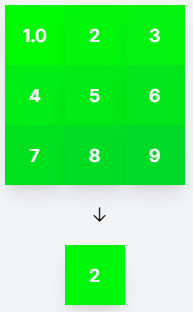
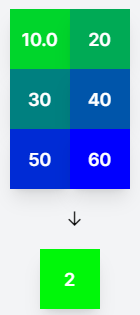

In [ ]:
import torch
tensor1 = torch.Tensor([[1, 2, 3],
                        [4, 5, 6],
                        [7, 8, 9]])

tensor2 = torch.Tensor([[10.0,20],
                        [30,40],
                        [50,60]])

In [ ]:
def solution(x: torch.Tensor) -> torch.Tensor:
    """
    Computes the mean for each row of the 2D tensor and
    returns the index of the row with the highest mean value.

    Parameters:
    - tensor: A 2D tensor.

    Returns:
    - int: Index of the row with the highest mean.
    """
    ###### your code here: #####
    result = torch.argmax(x.mean(dim=1))
    ###### your code here: #####
    return result


In [ ]:
print(solution(tensor1))

tensor(2)


In [ ]:
print(solution(tensor2))

tensor(2)


# AutoGrad

One of the main reasons for using PyTorch in Deep Learning projects is that we can automatically get **gradients/derivatives** of functions that we define. We will mainly use PyTorch for implementing neural networks, and they are just fancy functions. If we use weight matrices in our function that we want to learn, then those are called the **parameters** or simply the **weights**.

If our neural network would output a single scalar value, we would talk about taking the **derivative**, but you will see that quite often we will have **multiple** output variables ("values"); in that case we talk about **gradients**. It's a more general term.

Given an input $\mathbf{x}$, we define our function by **manipulating** that input, usually by matrix-multiplications with weight matrices and additions with so-called bias vectors. As we manipulate our input, we are automatically creating a **computational graph**. This graph shows how to arrive at our output from our input.
PyTorch is a **define-by-run** framework; this means that we can just do our manipulations, and PyTorch will keep track of that graph for us. Thus, we create a dynamic computation graph along the way.

So, to recap: the only thing we have to do is to compute the **output**, and then we can ask PyTorch to automatically get the **gradients**.

> **Note:  Why do we want gradients?** Consider that we have defined a function, a neural net, that is supposed to compute a certain output $y$ for an input vector $\mathbf{x}$. We then define an **error measure** that tells us how wrong our network is; how bad it is in predicting output $y$ from input $\mathbf{x}$. Based on this error measure, we can use the gradients to **update** the weights $\mathbf{W}$ that were responsible for the output, so that the next time we present input $\mathbf{x}$ to our network, the output will be closer to what we want.

The first thing we have to do is to specify which tensors require gradients. By default, when we create a tensor, it does not require gradients.

``torch.Tensor`` is the central class of the package. If you set its attribute
``.requires_grad`` as ``True``, it **starts to track all operations on it**. When
you finish your computation you can call ``.backward()`` and have **all the
gradients computed automatically**. The gradient for this tensor will be
accumulated into ``.grad`` attribute.

To **stop a tensor from tracking history**, you can call ``.detach()`` to detach
it from the computation history, and to prevent future computation from being
tracked.

To **prevent tracking history (and using memory)**, you can also wrap the code block
in ``with torch.no_grad():``. This can be particularly helpful when evaluating a
model because the model may have trainable parameters with `requires_grad=True`,
but for which we don't need the gradients.

In order to get familiar with the concept of a computation graph, we will create one for the following function:

$$y = \frac{1}{\ell(x)}\sum_i \left[(x_i + 2)^2 + 3\right],$$

where we use $\ell(x)$ to denote the number of elements in $x$. In other words, we are taking a mean here over the operation within the sum. You could imagine that $x$ are our parameters, and we want to optimize (either maximize or minimize) the output $y$. For this, we want to obtain the gradients $\partial y / \partial \mathbf{x}$. For our example, we'll use $\mathbf{x}=[0,1,2]$ as our input.

In [ ]:
x = torch.arange(3, dtype=torch.float32, requires_grad=True) # Only float tensors can have gradients
print("X", x)

X tensor([0., 1., 2.], requires_grad=True)


Now let's build the computation graph step by step. You can combine multiple operations in a single line, but we will separate them here to get a better understanding of how each operation is added to the computation graph.

In [ ]:
a = x + 2
b = a ** 2
c = b + 3
y = c.mean()
print("Y", y)

Y tensor(12.6667, grad_fn=<MeanBackward0>)


Using the statements above, we have created a computation graph that looks similar to the figure below:

<center style="width: 100%"><img src="https://github.com/phlippe/uvadlc_notebooks/blob/master/docs/tutorial_notebooks/tutorial2/pytorch_computation_graph.svg?raw=1" width="200px"></center>

We calculate $a$ based on the inputs $x$ and the constant $2$, $b$ is $a$ squared, and so on. The visualization is an abstraction of the dependencies between inputs and outputs of the operations we have applied.
Each node of the computation graph has automatically defined a function for calculating the gradients with respect to its inputs, `grad_fn`. You can see this when we printed the output tensor $y$. This is why the computation graph is usually visualized in the reverse direction (arrows point from the result to the inputs). We can perform backpropagation on the computation graph by calling the function `backward()` on the last output, which effectively calculates the gradients for each tensor that has the property `requires_grad=True`:

In [ ]:
y.backward()

`x.grad` will now contain the gradient $\partial y/ \partial \mathcal{x}$, and this gradient indicates how a change in $\mathbf{x}$ will affect output $y$ given the current input $\mathbf{x}=[0,1,2]$:

In [ ]:
print(x.grad)

tensor([1.3333, 2.0000, 2.6667])


We can also verify these gradients by hand. We will calculate the gradients using the chain rule, in the same way as PyTorch did it:

$$\frac{\partial y}{\partial x_i} = \frac{\partial y}{\partial c_i}\frac{\partial c_i}{\partial b_i}\frac{\partial b_i}{\partial a_i}\frac{\partial a_i}{\partial x_i}$$

Note that we have simplified this equation to index notation, and by using the fact that all operation besides the mean do not combine the elements in the tensor. The partial derivatives are:

$$
\frac{\partial a_i}{\partial x_i} = 1,\hspace{1cm}
\frac{\partial b_i}{\partial a_i} = 2\cdot a_i\hspace{1cm}
\frac{\partial c_i}{\partial b_i} = 1\hspace{1cm}
\frac{\partial y}{\partial c_i} = \frac{1}{3}
$$

Hence, with the input being $\mathbf{x}=[0,1,2]$, our gradients are $\partial y/\partial \mathbf{x}=[4/3,2,8/3]$. The previous code cell should have printed the same result.

You can also stop autograd from tracking history on Tensors with `.requires_grad=True` either by wrapping the code block in with `torch.no_grad()`:

In [ ]:
print(x.requires_grad)
print((x ** 2).requires_grad)

with torch.no_grad():
    print((x ** 2).requires_grad)

True
True
False


Every time a variable is back propogated through, the gradient will be accumulated instead of being replaced. Calling `tensor.grad_zero()` would reset the gradients that have accumulated to 0.

## TASK

Find the Derivative of the following function below at $x = \frac{\pi}{2}$ using the PyTorch's AutoGrad


$$f(x) = log(e^{sin( x ) }+1+x^{4})$$

$$ f( \frac{\pi}{3}) =  log(e^{sin(  \frac{\pi}{2} ) }+1+ {\frac{\pi}{3}}^{4})\\ = 1.527$$


In [ ]:
import math
x = torch.tensor([math.pi / 3 ], requires_grad=True)
sinx = torch.sin(x)
esinx = torch.exp(sinx)
x_4 = torch.pow(x,4)
v = esinx + 1 + x_4
f_x = torch.log(v)
print(f_x)

tensor([1.0472], requires_grad=True)
tensor([1.5217], grad_fn=<LogBackward0>)


$$ f^{\prime}(x) = \frac{1}{(e^{sin(x) }+1+x^{4})}[cos(x)\times e^{sin(x)}+4\cdot x^3]
$$

$$ f^{\prime}( \frac{\pi}{2}) = \frac{1}{(e^{sin( \frac{\pi}{2}) }+1+{ \frac{\pi}{2}}^{4})}[cos( \frac{\pi}{2})\times e^{sin({ \frac{\pi}{2}})}+4\cdot { \frac{\pi}{2}}^3] \\ = 1.2625
$$

In [ ]:
f_x.backward()
print(x.grad)

tensor([1.2625])


### GPU support

A crucial feature of PyTorch is the support of GPUs, short for Graphics Processing Unit. A GPU can perform many thousands of small operations in parallel, making it very well suitable for performing large matrix operations in neural networks. When comparing GPUs to CPUs, we can list the following main differences (credit: [Kevin Krewell, 2009](https://blogs.nvidia.com/blog/2009/12/16/whats-the-difference-between-a-cpu-and-a-gpu/))

<center style="width: 100%"><img src="https://github.com/phlippe/uvadlc_notebooks/blob/master/docs/tutorial_notebooks/tutorial2/comparison_CPU_GPU.png?raw=1" width="700px"></center>

CPUs and GPUs have both different advantages and disadvantages, which is why many computers contain both components and use them for different tasks. In case you are not familiar with GPUs, you can read up more details in this [NVIDIA blog post](https://blogs.nvidia.com/blog/2009/12/16/whats-the-difference-between-a-cpu-and-a-gpu/) or [here](https://www.intel.com/content/www/us/en/products/docs/processors/what-is-a-gpu.html).

GPUs can accelerate the training of your network up to a factor of $100$ which is essential for large neural networks. PyTorch implements a lot of functionality for supporting GPUs (mostly those of NVIDIA due to the libraries [CUDA](https://developer.nvidia.com/cuda-zone) and [cuDNN](https://developer.nvidia.com/cudnn)). First, let's check whether you have a GPU available:

In [ ]:
gpu_avail = torch.cuda.is_available()
print(f"Is the GPU available? {gpu_avail}")

Is the GPU available? True


By default, all tensors you create are stored on the CPU. We can push a tensor to the GPU by using the function `.to(...)`, or `.cuda()`. However, it is often a good practice to define a `device` object in your code which points to the GPU if you have one, and otherwise to the CPU. Then, you can write your code with respect to this device object, and it allows you to run the same code on both a CPU-only system, and one with a GPU. Let's try it below. We can specify the device as follows:

In [ ]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print("Device", device)

Device cuda


Now let's create a tensor and push it to the device:

In [ ]:
x = torch.zeros(2, 3)
x = x.to(device)
print("X", x)

X tensor([[0., 0., 0.],
        [0., 0., 0.]], device='cuda:0')


In case you have a GPU, you should now see the attribute `device='cuda:0'` being printed next to your tensor. The zero next to cuda indicates that this is the zero-th GPU device on your computer. PyTorch also supports multi-GPU systems, but this you will only need once you have very big networks to train (if interested, see the [PyTorch documentation](https://pytorch.org/docs/stable/distributed.html#distributed-basics)). We can also compare the runtime of a large matrix multiplication on the CPU with a operation on the GPU:

In [ ]:
x = torch.randn(5000, 5000)

## CPU version
start_time = time.time()
_ = torch.matmul(x, x)
end_time = time.time()
print(f"CPU time: {(end_time - start_time):6.5f}s")

## GPU version
x = x.to(device)
_ = torch.matmul(x, x)  # First operation to 'burn in' GPU
# CUDA is asynchronous, so we need to use different timing functions
start = torch.cuda.Event(enable_timing=True)
end = torch.cuda.Event(enable_timing=True)
start.record()
_ = torch.matmul(x, x)
end.record()
torch.cuda.synchronize()  # Waits for everything to finish running on the GPU
print(f"GPU time: {0.001 * start.elapsed_time(end):6.5f}s")  # Milliseconds to seconds

CPU time: 3.89789s
GPU time: 0.08762s


Depending on the size of the operation and the CPU/GPU in your system, the speedup of this operation can be >50x. As `matmul` operations are very common in neural networks, we can already see the great benefit of training a NN on a GPU. The time estimate can be relatively noisy here because we haven't run it for multiple times. Feel free to extend this, but it also takes longer to run.

When generating random numbers, the seed between CPU and GPU is not synchronized. Hence, we need to set the seed on the GPU separately to ensure a reproducible code. Note that due to different GPU architectures, running the same code on different GPUs does not guarantee the same random numbers. Still, we don't want that our code gives us a different output every time we run it on the exact same hardware. Hence, we also set the seed on the GPU:

In [ ]:
# GPU operations have a separate seed we also want to set
if torch.cuda.is_available():
    torch.cuda.manual_seed(42)
    torch.cuda.manual_seed_all(42)

# Additionally, some operations on a GPU are implemented stochastic for efficiency
# We want to ensure that all operations are deterministic on GPU (if used) for reproducibility
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# PyTorch Data Utilities


Documentation:
[Read Docs](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html)

### Downloading the MNIST Dataset

In [ ]:
train_url = "https://drive.google.com/file/d/1VfbyjiWl4cbtrdR8_T_JmAluRpbJZ6Qe/view?usp=sharing"
test_url = "https://drive.google.com/file/d/1MPrtpRCGKx1KxzZKFOKZEzsf1jkyhvG2/view?usp=sharing"
down_folder = "/content/downloaded"
os.makedirs(down_folder,exist_ok=True)
gdown.download(train_url , output= f"{down_folder}/mnist_train.csv" , fuzzy=True)
gdown.download(test_url , output= f"{down_folder}/mnist_test.csv" , fuzzy=True)

Downloading...
From (original): https://drive.google.com/uc?id=1VfbyjiWl4cbtrdR8_T_JmAluRpbJZ6Qe
From (redirected): https://drive.google.com/uc?id=1VfbyjiWl4cbtrdR8_T_JmAluRpbJZ6Qe&confirm=t&uuid=f3e4dbd6-7a5e-44eb-8b54-3c969a8ca2f9
To: /content/downloaded/mnist_train.csv
100%|██████████| 110M/110M [00:01<00:00, 96.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1MPrtpRCGKx1KxzZKFOKZEzsf1jkyhvG2
To: /content/downloaded/mnist_test.csv
100%|██████████| 18.3M/18.3M [00:00<00:00, 77.3MB/s]


'/content/downloaded/mnist_test.csv'

## Helper Functions

In [ ]:
def train_test_split_custom(X, y, test_size=0.2, random_state=None, stratify=None):


    if random_state is not None:
        np.random.seed(random_state)
    if isinstance(test_size, float):
        test_size = int(test_size * len(X))
    indices = np.arange(len(X))
    np.random.shuffle(indices)
    if stratify is not None:
        stratify_indices = np.argsort(stratify)
        indices = indices[stratify_indices]

    test_indices = indices[:test_size]
    train_indices = indices[test_size:]

    X_train, X_test = X[train_indices], X[test_indices]
    y_train, y_test = y[train_indices], y[test_indices]

    return X_train, X_test, y_train, y_test


In [ ]:
# Load MNIST train.csv file without using pandas or csv library
def load_mnist(file_path):
    data = []
    with open(file_path, 'r') as file:
        for line in file:
            row = line.strip().split(',')
            data.append(row)

    return np.array(data[1:],dtype=int),data[0]

# Save data to CSV file
def save_to_csv(file_path, data,columns):
    with open(file_path, 'w') as file:
        file.write(','.join(map(str,columns)) + '\n')
        for row in data:
            row_str = ','.join(map(str, row))
            file.write(row_str + '\n')

# MNIST train.csv file path
mnist_file_path = down_folder + "/mnist_train.csv"

# Load MNIST data
mnist_data,columns = load_mnist(mnist_file_path)

# Separate features (X) and labels (y)
X = mnist_data[:, 1:]
y = mnist_data[:, 0]

# Perform train-test split
X_train, X_test, y_train, y_test = train_test_split_custom(X, y, test_size=0.2, random_state=42, stratify=y)

# Save train and test datasets to separate CSV files
save_to_csv(down_folder+"/mnist_train_split.csv", np.column_stack((y_train, X_train)),columns)
save_to_csv(down_folder+"/mnist_val_split.csv", np.column_stack((y_test, X_test)),columns)


## Define the Custom Dataset Class

`torch.utils.data.Dataset` is an abstract class representing a dataset. Your custom dataset should inherit Dataset and override the following methods:
* `__len__` so that len(dataset) returns the size of the dataset.
* `__getitem__` to support indexing such that `dataset[i]` can be used to get $i^{th}$ sample in the Dataset


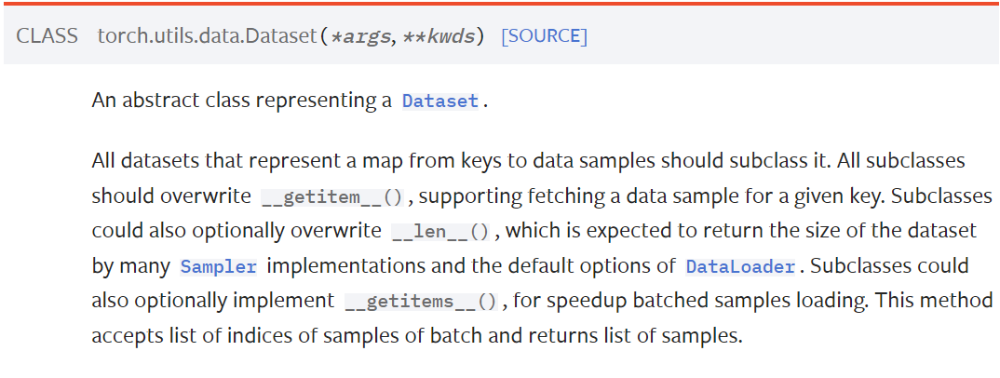

In [ ]:
class CustomMNIST(torch.utils.data.Dataset):
    filenames = {"train":"mnist_train_split.csv",
                 "val":"mnist_val_split.csv",
                 "test" :"mnist_test.csv" }

    def __init__(
            self,
            root:str ="./datasets/",
            type_:str = "train",
            normalize:bool = True):  # IMPORTANT
        """
        Args:
            root             : Folder to store the dataset
            type_             : choose the type_ of the data
            normalize        : Normalize the dataset

        """
        self.root = root
        self.type_ = type_
        self.normalize = normalize
        self.images  = self.read_data_label()


    def read_data_label(self) -> Tuple[np.ndarray,np.ndarray]: # HELPER FUNCTION
        """
            Args: None
            Returns:
                tuple : ((image),(target)) whare is
            Read the Extracted file from the Yann LeCunn extracted data
            and use that extracted file to read the images
        """

        images_filepath = os.path.join(self.root,self.filenames[self.type_])
        images = self.load_csv_file(images_filepath)
        # First element in each column is the image label
        images = [list(map(int,img)) for img in images[1:]]

        return images

    def load_csv_file(self,file_path):
        data = []
        with open(file_path, 'r') as file:
            for line in file:
                row = line.strip().split(',')
                data.append(row)
        return data

    def __len__(self) -> int:  # IMPORTANT
        return len(self.images)

    def img_normalize(self,img_tensor:torch.Tensor) -> torch.Tensor:
        mean = img_tensor.mean() + 1e-8 # For numerical stability
        std = img_tensor.std() + 1e-8
        return img_tensor.sub_(mean).div_(std)

    def __getitem__(self, idx:int) -> Tuple[torch.Tensor,torch.Tensor]: # IMPORTANT
        """
            Args:
                idx : int (index of the datapoint in the dataset)
            Returns:
                tuple(torch.Tensor,torch.Tensor) -> (img,target)
        """
        img, target = self.images[idx][1:], self.images[idx][0]
        img = torch.tensor(img,dtype=torch.float32).view(28,28)
        target = torch.tensor(target,dtype=torch.float32)

        if self.normalize:
            img = self.img_normalize(img)

        target=target.view(1)
        return img, target

In [ ]:
# Define the Batch Size
batchSize = 64
# Load the Custom Train, Val and Test Dataset
trainCustomDataset = CustomMNIST(type_="train",root=down_folder, normalize=True)
valCustomDataset = CustomMNIST(type_="val",root=down_folder, normalize=True)
testCustomDataset = CustomMNIST(type_="test",root=down_folder,normalize=True)

## Define the DataLoader for the above Custom MNIST Dataset

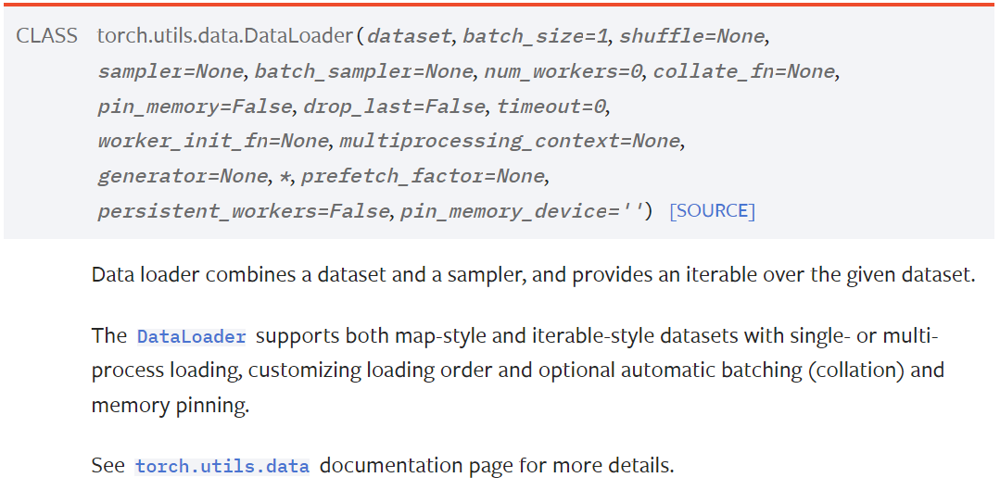

**DATALOADER ARGUEMENTS:**

1. `dataset` (Dataset): dataset from which to load the data.

2. `batch_size` (int, optional): how many samples per batch to load (default: ``1``).

3. `shuffle` (bool, optional): set to ``True`` to have the data reshuffled at every epoch (default: ``False``).

4. `sampler` (Sampler or Iterable, optional): defines the strategy to draw samples from the dataset. Can be any ``Iterable`` with ``__len__`` implemented. If specified, `shuffle` must not be specified.

5. `batch_sampler` (Sampler or Iterable, optional): like `sampler`, but returns a batch of indices at a time. Mutually exclusive with `batch_size`, `shuffle`,`sampler`,   and `drop_last`.

6. `num_workers` (int, optional): how many subprocesses to use for data loading. ``0`` means that the data will be loaded in the main. (default: ``0``)

7. `collate_fn` (Callable, optional): merges a list of samples to form a mini-batch of Tensor(s).  Used when using batched loading from a map-style dataset.

8. `pin_memory` (bool, optional): If ``True``, the data loader will copy Tensors into device/CUDA pinned memory before returning them.  If your data elements are a custom type, or your `collate_fn` returns a batch that is a custom type, see the example below.

9. `drop_last` (bool, optional): set to ``True`` to drop the last incomplete batch, if the dataset size is not divisible by the batch size. If ``False`` and the size of dataset is not divisible by the batch size, then the last batch will be smaller. (default: ``False``)

10. `timeout` (numeric, optional): if positive, the timeout value for collecting a batch from workers. Should always be non-negative. (default: ``0``)

11. `worker_init_fn` (Callable, optional): If not ``None``, this will be called on each worker subprocess with the worker id (an int in ``[0, num_workers - 1]``) as input, after seeding and before data loading. (default: ``None``)

12. `multiprocessing_context` (str or multiprocessing.context.BaseContext, optional): If ``None``, the default `multiprocessing context`_ of your operating system will be used. (default: ``None``)

13. `generator` (torch.Generator, optional): If not ``None``, this RNG will be used by RandomSampler to generate random indexes and multiprocessing to generate ``base_seed`` for workers. (default: ``None``)

14. `prefetch_factor` (int, optional, keyword-only arg): Number of batches loaded in advance by each worker. ``2`` means there will be a total of 2 * num_workers batches prefetched across all workers.  (default value depends on the set value for num_workers. If value of num_workers=0 default is ``None``. Otherwise, if value of ``num_workers > 0`` default is ``2``).

15. `persistent_workers` (bool, optional): If ``True``, the data loader will not shut down the worker processes after a dataset has been consumed once. This allows to maintain the workers `Dataset` instances alive. (default: ``False``) pin_memory_device (str, optional): the device to `pin_memory` to if ``pin_memory`` is ``True``.

More About how a DataLoader works under the Hood - https://youtu.be/Sj-gIb0QiRM?si=z8-lDrmyEp7hWbKS

Advance Question - https://discuss.pytorch.org/t/when-does-a-pytorch-dataset-worker-pull-new-data/153286/3


In [ ]:
batchSize = 2
trainLoader =  torch.utils.data.DataLoader(trainCustomDataset,batch_size=batchSize,shuffle=True)
valLoader =  torch.utils.data.DataLoader(valCustomDataset,batch_size=batchSize)
testLoader = torch.utils.data.DataLoader(testCustomDataset,batch_size = batchSize)

tensor([[[-0.4122, -0.4122, -0.4122,  ..., -0.4122, -0.4122, -0.4122],
         [-0.4122, -0.4122, -0.4122,  ..., -0.4122, -0.4122, -0.4122],
         [-0.4122, -0.4122, -0.4122,  ..., -0.4122, -0.4122, -0.4122],
         ...,
         [-0.4122, -0.4122, -0.4122,  ..., -0.4122, -0.4122, -0.4122],
         [-0.4122, -0.4122, -0.4122,  ..., -0.4122, -0.4122, -0.4122],
         [-0.4122, -0.4122, -0.4122,  ..., -0.4122, -0.4122, -0.4122]],

        [[-0.4722, -0.4722, -0.4722,  ..., -0.4722, -0.4722, -0.4722],
         [-0.4722, -0.4722, -0.4722,  ..., -0.4722, -0.4722, -0.4722],
         [-0.4722, -0.4722, -0.4722,  ..., -0.4722, -0.4722, -0.4722],
         ...,
         [-0.4722, -0.4722, -0.4722,  ..., -0.4722, -0.4722, -0.4722],
         [-0.4722, -0.4722, -0.4722,  ..., -0.4722, -0.4722, -0.4722],
         [-0.4722, -0.4722, -0.4722,  ..., -0.4722, -0.4722, -0.4722]]])
torch.Size([2, 28, 28])
tensor([[2.],
        [0.]])


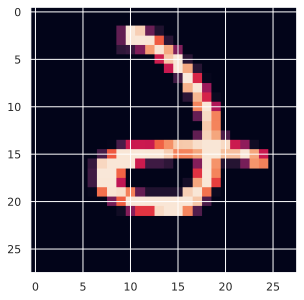

In [ ]:
for i, (img,target) in enumerate(trainLoader):
    print(img)
    print(img.shape)
    plt.imshow(img[0].numpy())
    print(target)
    break

# Collate function

A dataloader parameter which can be customized to achieve custom automatic batching.

You may apply some transformation in the collate function;
One can choose to apply transformation in the collate function instead of `Dataset` class if transformation needs to be applied on batches.
Also, since data loader support multiprocess through multi-workers, hence ```collate_fn()``` also can take advantage of multi-workers performance speed up.

In [ ]:
# Create an object of the custom dataset class
class MyNormalDataset(torch.utils.data.Dataset):
    # constructor, in this case it contains the data
    def __init__(self, xs, ys):
        self.input = input
        self.target = target

    # returns the length of the dataset
    def __len__(self):
        return len(self.input)

    # returns the item at index i
    def __getitem__(self, i):
        return self.input[i], self.target[i]# create a dict of arguments, another way of passing arguments

    def collate_fn(self, batch):
        x, y = zip(*batch)
        x_mean = np.mean(x)
        x_std = np.std(x)
        x_normal = (x-x_mean)/(x_std+1e-9)
        return x_normal, y


input = np.array(list(range(10)))
target = np.array(list(range(0, 20, 2)))
print('input values: ', input)
print('target values: ', target)

# Create an instance of MyDataset class
dataset = MyNormalDataset(input, target)
# Use the custom collate_fn
# pass the arguments
train_dataloader_custom = torch.utils.data.DataLoader(dataset, batch_size=5, shuffle=True, collate_fn= dataset.collate_fn)

# Display collated inputs and labels.
for i, (x, y) in enumerate(train_dataloader_custom):
    print(f"batch of inputs: {x}, batch of labels: {y}")

NameError: name 'Dataset' is not defined

In [ ]:
from PIL import Image
from os.path import join
import scipy.io
from torchvision.datasets.utils import download_url, list_dir, list_files
import torchvision
import torch
import os

class StanfordDogs(torch.utils.data.Dataset):
    """`Stanford Dogs <http://vision.stanford.edu/aditya86/ImageNetDogs/>`_ Dataset.
    Args:
        root (string): Root directory of dataset where directory

        train (bool): Specify the split to choose. (train/test)

        transform (callable, optional): A function/transform that  takes in an PIL image
            and returns a transformed version. E.g, ``transforms.RandomCrop``

        target_transform (callable, optional): A function/transform that takes in the
            target and transforms it.

        download (bool, optional): If true, downloads the dataset tar files from the internet and
            puts it in root directory. If the tar files are already downloaded, they are not
            downloaded again.
    """
    folder = 'StanfordDogs'
    download_url_prefix = 'http://vision.stanford.edu/aditya86/ImageNetDogs'

    def __init__(self,
                 root,
                 train=True,
                 transform=None,
                 target_transform=None,
                 download=True):

        self.root = join(os.path.expanduser(root), self.folder)
        self.train = train
        self.transform = transform
        self.target_transform = target_transform

        if download:
            self.download()

        # Load the split (train or test) of the dataset
        split = self.load_split()

        self.images_folder = join(self.root, 'Images')
        self.annotations_folder = join(self.root, 'Annotation')
        self._breeds = list_dir(self.images_folder)

        # Flatten breed images with their respective classes
        self._breed_images = [(annotation+'.jpg', idx) for annotation, idx in split]

        # This Variable contains all the Dataset. HINT: Use this variable for the task.
        self._flat_breed_images = self._breed_images


        # List of all classes in the dataset
        self.classes = ["Chihuaha", "Japanese Spaniel", "Maltese Dog", "Pekinese", "Shih-Tzu", "Blenheim Spaniel",
                        "Papillon", "Toy Terrier", "Rhodesian Ridgeback", "Afghan Hound", "Basset Hound", "Beagle",
                        "Bloodhound", "Bluetick", "Black-and-tan Coonhound", "Walker Hound", "English Foxhound",
                        "Redbone", "Borzoi", "Irish Wolfhound", "Italian Greyhound", "Whippet", "Ibizian Hound",
                        "Norwegian Elkhound", "Otterhound", "Saluki", "Scottish Deerhound", "Weimaraner",
                        "Staffordshire Bullterrier", "American Staffordshire Terrier", "Bedlington Terrier",
                        "Border Terrier", "Kerry Blue Terrier", "Irish Terrier", "Norfolk Terrier", "Norwich Terrier",
                        "Yorkshire Terrier", "Wirehaired Fox Terrier", "Lakeland Terrier", "Sealyham Terrier",
                        "Airedale", "Cairn", "Australian Terrier", "Dandi Dinmont", "Boston Bull", "Miniature Schnauzer",
                        "Giant Schnauzer", "Standard Schnauzer", "Scotch Terrier", "Tibetan Terrier", "Silky Terrier",
                        "Soft-coated Wheaten Terrier", "West Highland White Terrier", "Lhasa", "Flat-coated Retriever",
                        "Curly-coated Retriever", "Golden Retriever", "Labrador Retriever", "Chesapeake Bay Retriever",
                        "German Short-haired Pointer", "Vizsla", "English Setter", "Irish Setter", "Gordon Setter",
                        "Brittany", "Clumber", "English Springer Spaniel", "Welsh Springer Spaniel", "Cocker Spaniel",
                        "Sussex Spaniel", "Irish Water Spaniel", "Kuvasz", "Schipperke", "Groenendael", "Malinois",
                        "Briard", "Kelpie", "Komondor", "Old English Sheepdog", "Shetland Sheepdog", "Collie",
                        "Border Collie", "Bouvier des Flandres", "Rottweiler", "German Shepard", "Doberman",
                        "Miniature Pinscher", "Greater Swiss Mountain Dog", "Bernese Mountain Dog", "Appenzeller",
                        "EntleBucher", "Boxer", "Bull Mastiff", "Tibetan Mastiff", "French Bulldog", "Great Dane",
                        "Saint Bernard", "Eskimo Dog", "Malamute", "Siberian Husky", "Affenpinscher", "Basenji",
                        "Pug", "Leonberg", "Newfoundland", "Great Pyrenees", "Samoyed", "Pomeranian", "Chow",
                        "Keeshond", "Brabancon Griffon", "Pembroke", "Cardigan", "Toy Poodle", "Miniature Poodle",
                        "Standard Poodle", "Mexican Hairless", "Dingo", "Dhole", "African Hunting Dog"]

    def __len__(self):
        """
        TODO:  Write the Code to return the total number of images present in the dataset
        """
        len_data = len(self._flat_breed_images)
        return len_data

    def __getitem__(self, index):
        """
        TODO: You will be given an index of an image for which you have to return the
        corresponding Image in torch.Tensor and its class.

        Args:
            index (int): Index
        Returns:
            tuple: (image, target) where target is index of the target character class.
        """

        """
        HINT:
        1. Get the image name and target class from the _flat_breed_images list using the index
        2. Load the image using torchvision.io.read_image
        3. Resize the Image to (H,W) = (200,200) using torchvision transforms
        4. Apply image transformations if provided.
        5. Apply target transformations if provided.
        6. Return the image, target class.
        """
        # Write your code below
        image_name, target_class = self._flat_breed_images[index]
        image_path = join(self.images_folder, image_name)
        image = torchvision.io.read_image(image_path)

        # Resize the image
        resize = torchvision.transforms.Resize((200,200))
        image = resize(image)

        # Apply image transformations if provided
        if self.transform:

            image = self.transform(image)

        # Apply target transformations if provided
        if self.target_transform:
            target_class = self.target_transform(target_class)

        return image, target_class

    def download(self):
        """
        Download the dataset from the Stanford Dogs website if it's not already present
        in the specified root directory.
        """
        import tarfile

        if os.path.exists(join(self.root, 'Images')) and os.path.exists(join(self.root, 'Annotation')):
            if len(os.listdir(join(self.root, 'Images'))) == len(os.listdir(join(self.root, 'Annotation'))) == 120:
                print('Files already downloaded and verified')
                return

        for filename in ['images', 'annotation', 'lists']:
            tar_filename = filename + '.tar'
            url = self.download_url_prefix + '/' + tar_filename
            download_url(url, self.root, tar_filename, None)
            print('Extracting downloaded file: ' + join(self.root, tar_filename))
            with tarfile.open(join(self.root, tar_filename), 'r') as tar_file:
                tar_file.extractall(self.root)
            os.remove(join(self.root, tar_filename))

    @staticmethod
    def get_boxes(path):
        """
        Extract bounding box coordinates from annotation XML file.

        Args:
            path (string): Path to the annotation file
        Returns:
            list: List of bounding boxes with coordinates (xmin, ymin, xmax, ymax)
        """
        import xml.etree.ElementTree
        e = xml.etree.ElementTree.parse(path).getroot()
        boxes = []
        for objs in e.iter('object'):
            boxes.append([int(objs.find('bndbox').find('xmin').text),
                          int(objs.find('bndbox').find('ymin').text),
                          int(objs.find('bndbox').find('xmax').text),
                          int(objs.find('bndbox').find('ymax').text)])
        return boxes

    def load_split(self):
        """
        Load the dataset split (train or test) based on the train flag.

        Returns:
            list: List of tuples containing image annotation and corresponding label.
        """
        if self.train:
            split = scipy.io.loadmat(join(self.root, 'train_list.mat'))['annotation_list']
            labels = scipy.io.loadmat(join(self.root, 'train_list.mat'))['labels']
        else:
            split = scipy.io.loadmat(join(self.root, 'test_list.mat'))['annotation_list']
            labels = scipy.io.loadmat(join(self.root, 'test_list.mat'))['labels']

        split = [item[0][0] for item in split]
        labels = [item[0]-1 for item in labels]
        return list(zip(split, labels))

    def stats(self):
        """
        Print and return the statistics of the dataset including the number of samples per class.

        Returns:
            dict: Dictionary containing the count of samples per class.
        """
        counts = {}
        for index in range(len(self._flat_breed_images)):
            image_name, target_class = self._flat_breed_images[index]
            if target_class not in counts.keys():
                counts[target_class] = 1
            else:
                counts[target_class] += 1

        print("%d samples spanning %d classes (avg %f per class)" %
              (len(self._flat_breed_images), len(counts.keys()),
               float(len(self._flat_breed_images)) / float(len(counts.keys()))))

        return counts


## Initialize the Train and Test split and define the DataLoader

In [ ]:
trainDataset = StanfordDogs(root="./",
                            train=True)
testDataset = StanfordDogs(root="./",
                           train=False)

100%|██████████| 793579520/793579520 [00:52<00:00, 15185199.89it/s]


Extracting downloaded file: ./StanfordDogs/images.tar


100%|██████████| 21852160/21852160 [00:01<00:00, 11548763.52it/s]


Extracting downloaded file: ./StanfordDogs/annotation.tar


100%|██████████| 481280/481280 [00:00<00:00, 2293809.15it/s]


Extracting downloaded file: ./StanfordDogs/lists.tar
Files already downloaded and verified


In [ ]:
batch_size = 16
trainLoader = torch.utils.data.DataLoader(trainDataset,
                                          batch_size=batch_size,
                                          shuffle =True )
testLoader = torch.utils.data.DataLoader(testDataset,batch_size=batch_size, shuffle=False)

In [ ]:
for i in trainLoader:
    img, label = i
    print(len(img))
    break

16


# Torchvision

`torchvision` is a Python library that is part of the PyTorch ecosystem, designed specifically for computer vision tasks. It provides tools, utilities, and datasets that facilitate the development, training, and evaluation of deep learning models in the realm of image and video processing. Here’s a breakdown of its key components and why it is needed:

### Key Components of Torchvision

1. **Datasets**: Torchvision includes popular datasets like ImageNet, CIFAR-10, MNIST, COCO, and more. These datasets are ready-to-use and come with utilities to download, preprocess, and load them easily.

2. **Transforms**: This module provides a variety of image transformations for data augmentation and preprocessing. Common operations include resizing, cropping, normalization, and random transformations like rotation, flipping, and color jittering.

3. **Models**: Pretrained models such as ResNet, VGG, Inception, and MobileNet are available within `torchvision`. These models can be used for transfer learning or as a benchmark for comparison.

4. **Utils**: Utility functions to assist with various tasks such as visualizing images, bounding boxes, and segmentations. There are also utilities for non-maximum suppression, image normalization, and more.

5. **Ops**: Contains low-level operations for computer vision, such as non-maximum suppression, ROI align, and other custom CUDA kernels that are useful for building efficient vision models.

### Why We Need Torchvision

1. **Ease of Use**: Torchvision significantly reduces the boilerplate code needed to load datasets, preprocess images, and build models. This allows researchers and developers to focus more on model design and experimentation.

2. **Standardization**: By providing standardized implementations of common datasets and transformations, `torchvision` ensures reproducibility and comparability of results across different experiments and research papers.

3. **Pretrained Models**: Access to pretrained models enables transfer learning, where models pretrained on large datasets can be fine-tuned on smaller, domain-specific datasets. This saves time and computational resources while often improving performance.

4. **Comprehensive Tools**: The library includes a wide array of tools for every step in the computer vision pipeline, from data loading and transformation to model training and evaluation, streamlining the development workflow.

5. **Integration with PyTorch**: Being a part of the PyTorch ecosystem, `torchvision` integrates seamlessly with PyTorch’s modules for neural networks, optimization, and automatic differentiation, providing a cohesive framework for developing and deploying deep learning models.

`torchvision` is essential for simplifying and enhancing the development of computer vision applications. Its rich set of tools and resources help to streamline processes, foster reproducibility, and leverage the power of pretrained models, making it a valuable asset for both research and practical implementations in the field of computer vision.

In [ ]:
# CODE ADOPTED FROM TORCHVISION TUTORIALS
import matplotlib.pyplot as plt
import torch
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
from torchvision import tv_tensors
from torchvision.transforms.v2 import functional as F

# HELPER FUNCTION FOR PLOTTING THE IMAGES
def plot(imgs, row_title=None, **imshow_kwargs):
    num_imgs = len(imgs)
    if not isinstance(imgs[0], list):
        # Make a 2d grid even if there's just 1 row
        imgs = [imgs]

    num_rows = len(imgs)
    num_cols = len(imgs[0])
    if num_imgs == 1:
        _, axs = plt.subplots(nrows=num_rows, ncols=num_cols, squeeze=False )
    else:
        _, axs = plt.subplots(nrows=num_rows, ncols=num_cols, squeeze=False,figsize= (15,15) )
    for row_idx, row in enumerate(imgs):
        for col_idx, img in enumerate(row):
            boxes = None
            masks = None
            if isinstance(img, tuple):
                img, target = img
                if isinstance(target, dict):
                    boxes = target.get("boxes")
                    masks = target.get("masks")
                elif isinstance(target, tv_tensors.BoundingBoxes):
                    boxes = target
                else:
                    raise ValueError(f"Unexpected target type: {type(target)}")
            img = F.to_image(img)
            if img.dtype.is_floating_point and img.min() < 0:
                # Poor man's re-normalization for the colors to be OK-ish. This
                # is useful for images coming out of Normalize()
                img -= img.min()
                img /= img.max()

            img = F.to_dtype(img, torch.uint8, scale=True)
            if boxes is not None:
                img = draw_bounding_boxes(img, boxes, colors="yellow", width=3)
            if masks is not None:
                img = draw_segmentation_masks(img, masks.to(torch.bool), colors=["green"] * masks.shape[0], alpha=.65)

            ax = axs[row_idx, col_idx]
            ax.imshow(img.permute(1, 2, 0).numpy(), **imshow_kwargs)
            ax.set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

    if row_title is not None:
        for row_idx in range(num_rows):
            axs[row_idx, 0].set(ylabel=row_title[row_idx])

    plt.tight_layout()

In [ ]:
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt

import torch
from torchvision.transforms import v2

plt.rcParams["savefig.bbox"] = 'tight'

# Download the Image Folder
img_url = "https://drive.google.com/drive/folders/1vBsgTKpYo3Pah0ii9lEQ0FhLy7-V24XI?usp=drive_link"
gdown.download_folder(img_url , quiet=True)

torch.manual_seed(0)

orig_img = Image.open(Path(f'../content/assets') / 'astronaut.jpg')

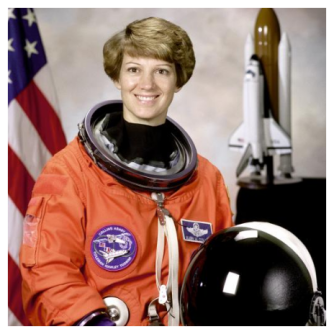

In [ ]:
# Plot the original Image
plot([orig_img])

# Geometric Transformations

Geometric image transformation refers to the process of altering the geometric properties of an image, such as its shape, size, orientation, or position. It involves applying mathematical operations to the image pixels or coordinates to achieve the desired transformation.

**Pad**

The `Pad` transform pads all image borders with some pixel values.

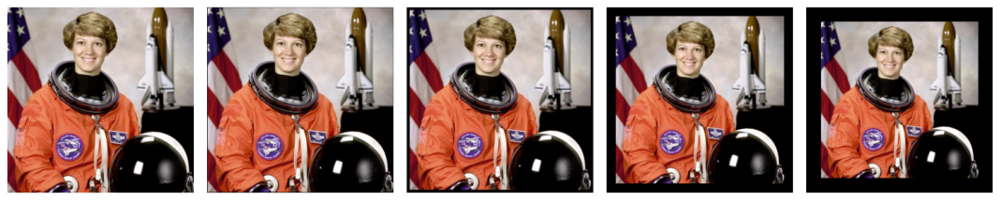

In [ ]:
padded_imgs = [v2.Pad(padding=padding)(orig_img) for padding in (3, 10, 30, 50)]
plot([orig_img] + padded_imgs)

**Resize**

The `Resize` transform resizes an image.

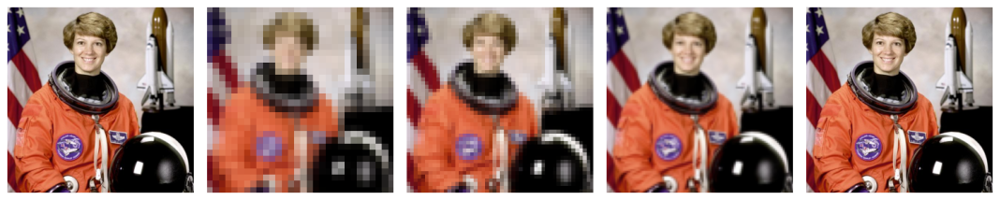

In [ ]:
resized_imgs = [v2.Resize(size=size)(orig_img) for size in (30, 50, 100, orig_img.size)]
plot([orig_img] + resized_imgs)

**CenterCrop**

The `CenterCrop` transform crops the given image at the center.




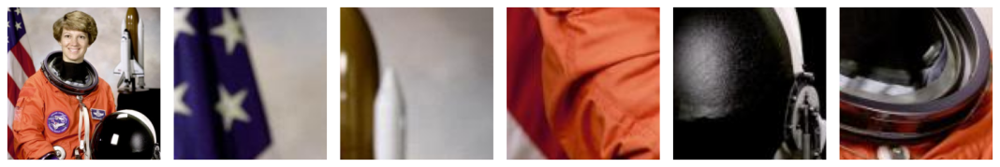

In [ ]:
(top_left, top_right, bottom_left, bottom_right, center) = v2.FiveCrop(size=(100, 100))(orig_img)
plot([orig_img] + [top_left, top_right, bottom_left, bottom_right, center])

**FiveCrop**

The `FiveCrop` transform crops the given image into four corners and the central crop.

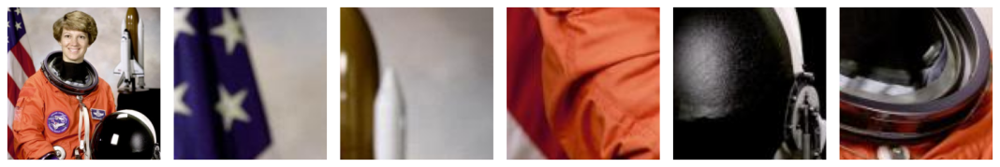

In [ ]:
(top_left, top_right, bottom_left, bottom_right, center) = v2.FiveCrop(size=(100, 100))(orig_img)
plot([orig_img] + [top_left, top_right, bottom_left, bottom_right, center])

**RandomPerspective**

The `RandomPerspective` transform performs random perspective transform on an image.


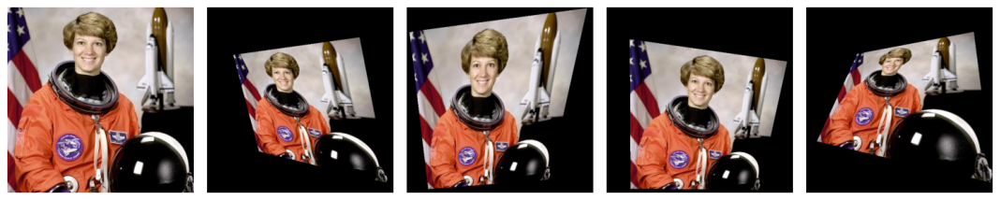

In [ ]:
perspective_transformer = v2.RandomPerspective(distortion_scale=0.6, p=1.0)
perspective_imgs = [perspective_transformer(orig_img) for _ in range(4)]
plot([orig_img] + perspective_imgs)

**RandomRotation**

The `RandomRotation` transform rotates an image with random angle.



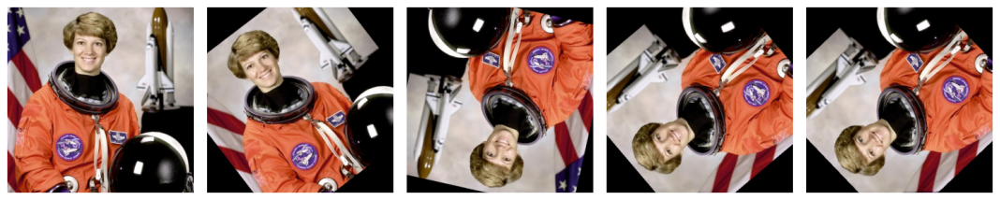

In [ ]:
rotater = v2.RandomRotation(degrees=(0, 180))
rotated_imgs = [rotater(orig_img) for _ in range(4)]
plot([orig_img] + rotated_imgs)

**RandomAffine**

The `RandomAffine` transform performs random affine transform on an image.



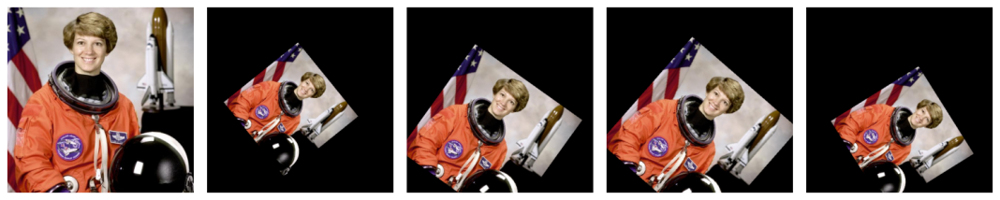

In [ ]:
affine_transfomer = v2.RandomAffine(degrees=(30, 70), translate=(0.1, 0.3), scale=(0.5, 0.75))
affine_imgs = [affine_transfomer(orig_img) for _ in range(4)]
plot([orig_img] + affine_imgs)

**RandomCrop**

The `RandomCrop` transform crops an image at a random location.

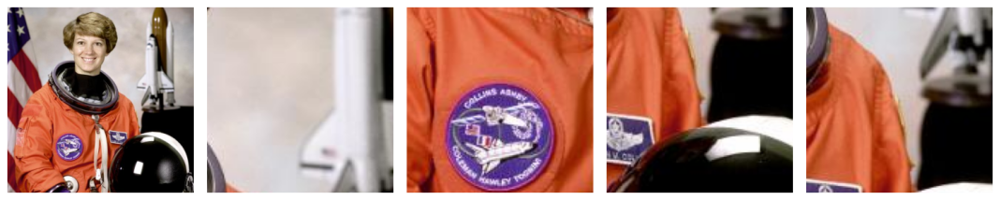

In [ ]:
cropper = v2.RandomCrop(size=(128, 128))
crops = [cropper(orig_img) for _ in range(4)]
plot([orig_img] + crops)

**RandomResizedCrop**

The `RandomResizedCrop` transform crops an image at a random location, and then resizes the crop to a given size.


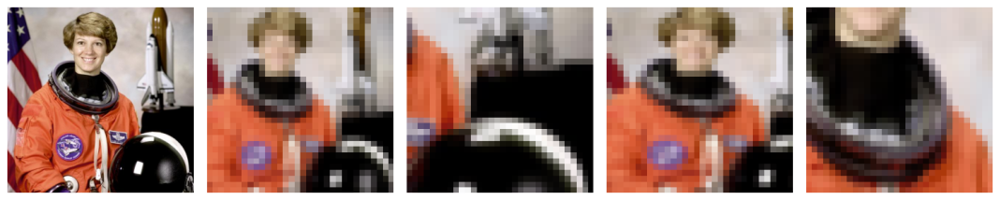

In [ ]:
resize_cropper = v2.RandomResizedCrop(size=(32, 32))
resized_crops = [resize_cropper(orig_img) for _ in range(4)]
plot([orig_img] + resized_crops)

# Photometric Transforms

Photometric image transformation refers to the process of modifying the photometric properties of an image, such as its brightness, contrast, color, or tone. These transformations are applied to change the visual appearance of an image while preserving its geometric structure.

Except `Grayscale`, the following transforms are random, which means that the same transform instance will produce different result each time it transforms a given image.

**Grayscale**

The `Grayscale` transform converts an image to grayscale

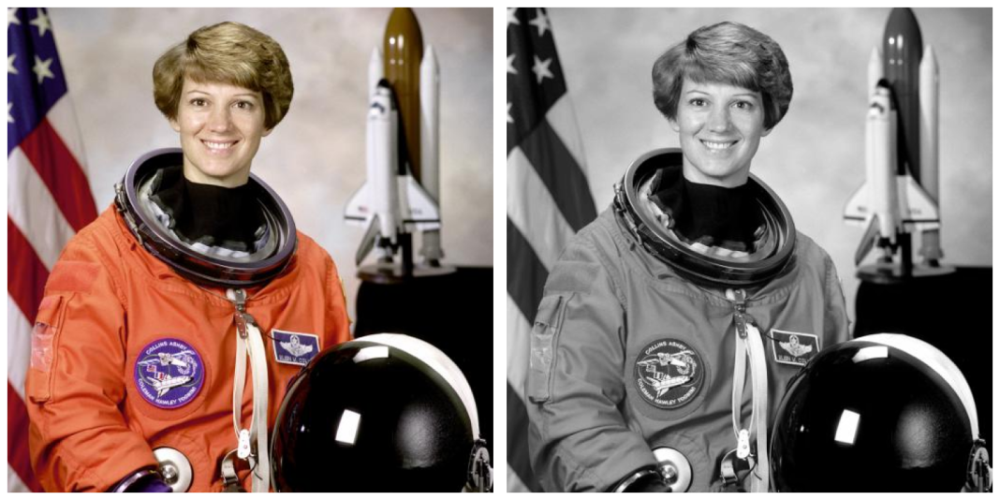

In [ ]:
gray_img = v2.Grayscale()(orig_img)
plot([orig_img, gray_img], cmap='gray')

**ColorJitter**

The `ColorJitter` transform randomly changes the brightness, contrast, saturation, hue, and other properties of an image.

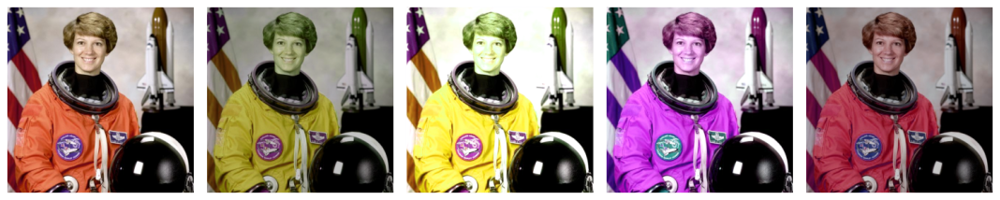

In [ ]:
jitter = v2.ColorJitter(brightness=.5, hue=.3)
jittered_imgs = [jitter(orig_img) for _ in range(4)]
plot([orig_img] + jittered_imgs)

**GaussianBlur**

The `GaussianBlur` transform performs gaussian blur transform on an image.

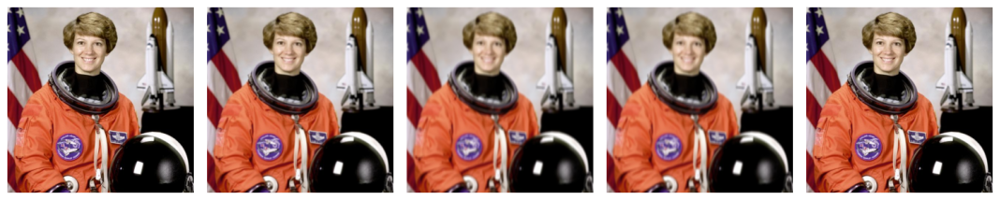

In [ ]:
blurrer = v2.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5.))
blurred_imgs = [blurrer(orig_img) for _ in range(4)]
plot([orig_img] + blurred_imgs)

**RandomInvert**

The `RandomInvert` transform randomly inverts the colors of the given image.

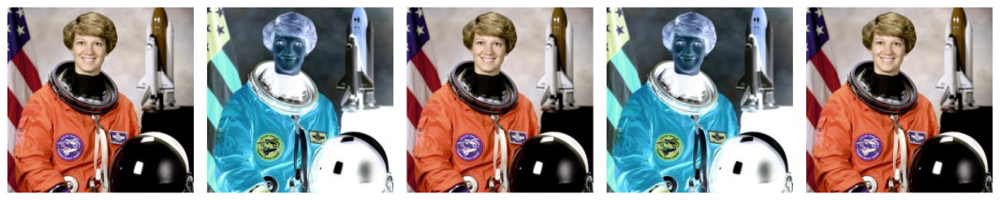

In [ ]:
inverter = v2.RandomInvert()
invertered_imgs = [inverter(orig_img) for _ in range(4)]
plot([orig_img] + invertered_imgs)

**RandomPosterize**

The `RandomPosterize` transform randomly posterizes the image by reducing the number of bits of each color channel.

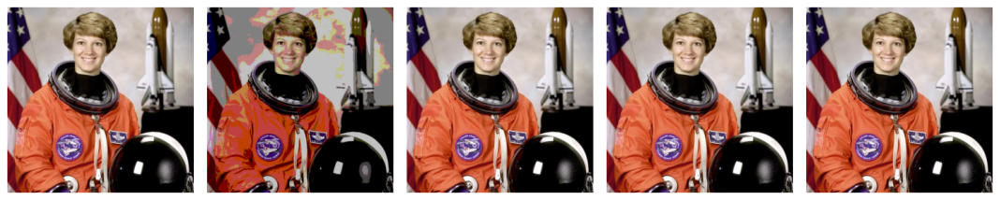

In [ ]:
posterizer = v2.RandomPosterize(bits=2)
posterized_imgs = [posterizer(orig_img) for _ in range(4)]
plot([orig_img] + posterized_imgs)

**RandomSolarize**

The `RandomSolarize` transform randomly solarizes the image by inverting all pixel values above the threshold.

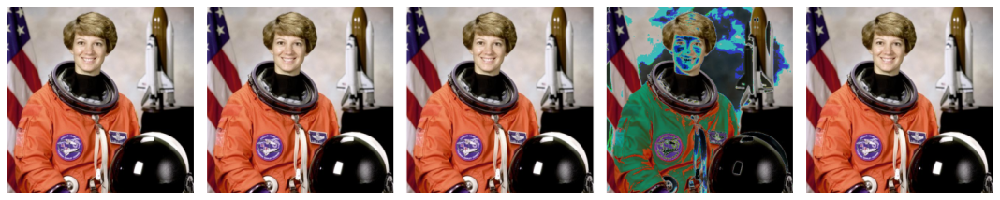

In [ ]:
solarizer = v2.RandomSolarize(threshold=192.0)
solarized_imgs = [solarizer(orig_img) for _ in range(4)]
plot([orig_img] + solarized_imgs)

**RandomAdjustSharpness**

The `RandomAdjustSharpness` transform randomly adjusts the sharpness of the given image.

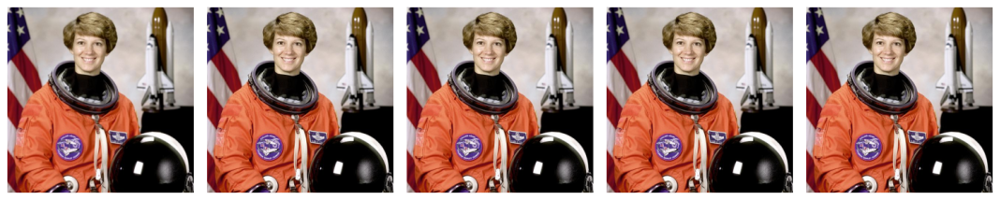

In [ ]:
sharpness_adjuster = v2.RandomAdjustSharpness(sharpness_factor=2)
sharpened_imgs = [sharpness_adjuster(orig_img) for _ in range(4)]
plot([orig_img] + sharpened_imgs)

**RandomAutocontrast**

The `RandomAutocontrast` transform randomly applies autocontrast to the given image.

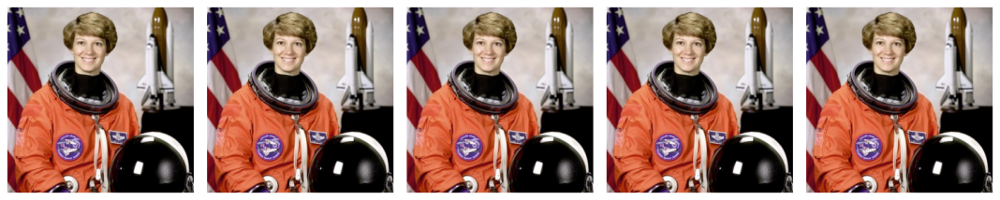

In [ ]:
autocontraster = v2.RandomAutocontrast()
autocontrasted_imgs = [autocontraster(orig_img) for _ in range(4)]
plot([orig_img] + autocontrasted_imgs)

**RandomEqualize**

The `RandomEqualize` transform randomly equalizes the histogram of the given image.

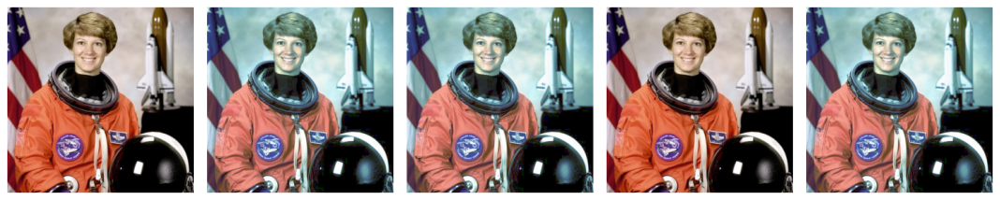

In [ ]:
equalizer = v2.RandomEqualize()
equalized_imgs = [equalizer(orig_img) for _ in range(4)]
plot([orig_img] + equalized_imgs)

# Randomly-applied Transforms

The following transforms are randomly-applied given a probability p. That is, given p = 0.5, there is a 50% chance to return the original image, and a 50% chance to return the transformed image, even when called with the same transform instance!

**RandomHorizontalFlip**

The `RandomHorizontalFlip` transform performs horizontal flip of an image, with a given probability.

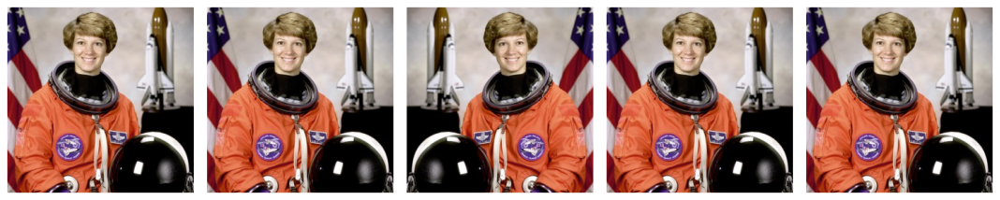

In [ ]:
hflipper = v2.RandomHorizontalFlip(p=0.5)
transformed_imgs = [hflipper(orig_img) for _ in range(4)]
plot([orig_img] + transformed_imgs)

**RandomVerticalFlip**

The `RandomVerticalFlip` transform performs vertical flip of an image, with a given probability.

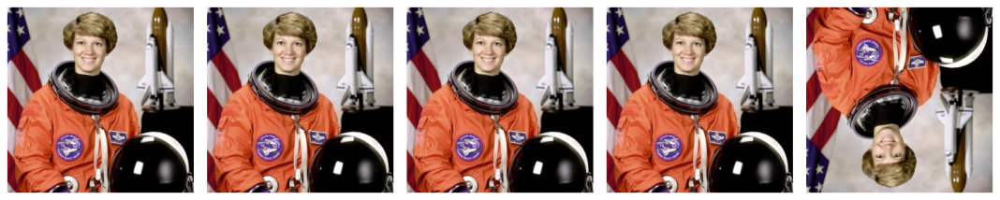

In [ ]:
vflipper = v2.RandomVerticalFlip(p=0.5)
transformed_imgs = [vflipper(orig_img) for _ in range(4)]
plot([orig_img] + transformed_imgs)

**RandomApply**

The `RandomApply` transform randomly applies a list of transforms, with a given probability.

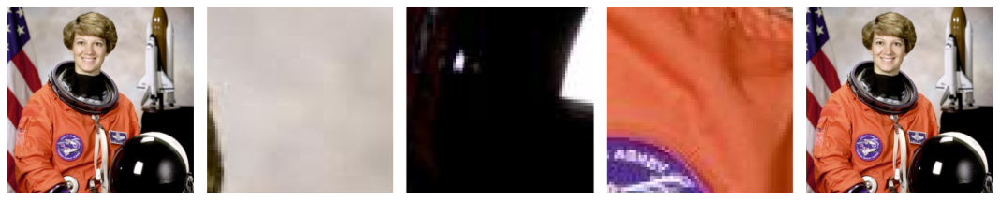

In [ ]:
applier = v2.RandomApply(transforms=[v2.RandomCrop(size=(64, 64))], p=0.5)
transformed_imgs = [applier(orig_img) for _ in range(4)]
plot([orig_img] + transformed_imgs)

I have list down some of the image transformations available in `torchvision`.

### torchvision.transforms

`torchvision.transforms` provides common image transformations for image preprocessing.

1. **Basic Transformations**
   - `transforms.Compose([transforms])`: Composes several transforms together.
   - `transforms.ToTensor()`: Converts a PIL Image or numpy.ndarray to a tensor.
   - `transforms.ToPILImage()`: Converts a tensor or numpy.ndarray to a PIL Image.
   
2. **Normalization and Scaling**
   - `transforms.Normalize(mean, std)`: Normalizes a tensor image with mean and standard deviation.
   - `transforms.Resize(size)`: Resizes the image to the given size.
   - `transforms.CenterCrop(size)`: Crops the given image at the center.
   - `transforms.RandomResizedCrop(size)`: Crops a random portion of the image and resizes it to the given size.
   
3. **Flipping and Rotation**
   - `transforms.RandomHorizontalFlip(p)`: Horizontally flips the image with a given probability.
   - `transforms.RandomVerticalFlip(p)`: Vertically flips the image with a given probability.
   - `transforms.RandomRotation(degrees)`: Rotates the image by a random angle.
   
4. **Color Transformations**
   - `transforms.ColorJitter(brightness, contrast, saturation, hue)`: Randomly changes the brightness, contrast, saturation, and hue of the image.
   - `transforms.Grayscale(num_output_channels)`: Converts the image to grayscale.
   
5. **Affine Transformations**
   - `transforms.RandomAffine(degrees, translate, scale, shear)`: Applies a random affine transformation.
   
6. **Other Transformations**
   - `transforms.Pad(padding)`: Pads the given image.
   - `transforms.Lambda(lambd)`: Applies a user-defined lambda as a transform.

### torchvision.transforms.functional

`torchvision.transforms.functional` provides lower-level operations for more control over transformations.

1. **Basic Transformations**
   - `F.to_tensor(pic)`: Converts a PIL Image or numpy.ndarray to a tensor.
   - `F.to_pil_image(pic)`: Converts a tensor or numpy.ndarray to a PIL Image.
   
2. **Normalization and Scaling**
   - `F.normalize(tensor, mean, std)`: Normalizes a tensor image with mean and standard deviation.
   - `F.resize(img, size)`: Resizes the image to the given size.
   - `F.center_crop(img, output_size)`: Crops the given image at the center.
   - `F.resized_crop(img, top, left, height, width, size)`: Crops the image and then resizes it.
   
3. **Flipping and Rotation**
   - `F.hflip(img)`: Horizontally flips the image.
   - `F.vflip(img)`: Vertically flips the image.
   - `F.rotate(img, angle)`: Rotates the image by the specified angle.
   
4. **Color Transformations**
   - `F.adjust_brightness(img, brightness_factor)`: Adjusts the brightness of the image.
   - `F.adjust_contrast(img, contrast_factor)`: Adjusts the contrast of the image.
   - `F.adjust_saturation(img, saturation_factor)`: Adjusts the saturation of the image.
   - `F.adjust_hue(img, hue_factor)`: Adjusts the hue of the image.
   - `F.rgb_to_grayscale(img, num_output_channels)`: Converts the image to grayscale.
   
5. **Affine Transformations**
   - `F.affine(img, angle, translate, scale, shear)`: Applies an affine transformation.
   
6. **Other Transformations**
   - `F.pad(img, padding)`: Pads the given image.
   - `F.crop(img, top, left, height, width)`: Crops the image at the specified location and size.


In [ ]:
!wget http://images.cocodataset.org/zips/train2014.zip

--2024-06-03 04:44:28--  http://images.cocodataset.org/zips/train2014.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.82.92, 52.217.106.60, 54.231.138.17, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.82.92|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13510573713 (13G) [application/zip]
Saving to: ‘train2014.zip’

train2014.zip       100%[===================>]  12.58G  57.6MB/s    in 4m 52s  

2024-06-03 04:49:20 (44.1 MB/s) - ‘train2014.zip’ saved [13510573713/13510573713]



 # Problem Statement - Part 1

Download the MNIST dataset (provide code to download in google colab) and
 create a custom dataloader using
 `torch.utils.data.Dataset`, `torch.utils.data.DataLoader`.Write another dataloader
 completely from scratch and compare the loading performance of your
 scratch-implemented data loader with the one written with PyTorch classes across
 different batch sizes (128, 256, 512, 1024). Plot a graph illustrating the
 relationship between batch size and loading time.

# Downloading MNIST and Creating DataLoaders

Creating a custom dataloader using `torch.utils.data.Dataset` and `DataLoader`, and writing another dataloader from scratch.


In [ ]:
# Import Libraries
import torch
import torchvision
import torchvision.transforms as transforms
import time
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
# Download MNIST dataset
transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])
train_dataset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform)
test_dataset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform)

# Prepare data loaders with batch size 128
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=128, shuffle=False)

# Part 2: Implementing and Training a Feed-Forward Neural Network

Implementing a Feed-Forward neural network with four hidden layers using `torch.nn.Linear`.


Epoch [1/5], Train Loss: 2.2185, Val Loss: 1.8259, Train Acc: 41.39%, Val Acc: 41.39%
Epoch [2/5], Train Loss: 1.2626, Val Loss: 0.8489, Train Acc: 71.94%, Val Acc: 71.94%
Epoch [3/5], Train Loss: 0.6628, Val Loss: 0.5170, Train Acc: 84.56%, Val Acc: 84.56%
Epoch [4/5], Train Loss: 0.4969, Val Loss: 0.4208, Train Acc: 87.77%, Val Acc: 87.77%
Epoch [5/5], Train Loss: 0.4022, Val Loss: 0.4260, Train Acc: 86.51%, Val Acc: 86.51%


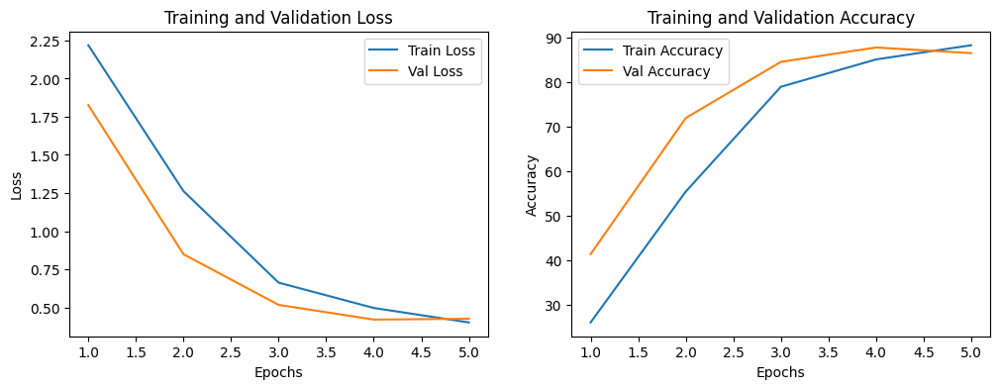

Model saved as feedforward_nn_model.pt


In [ ]:
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import random_split

# Define Feed-Forward Neural Network
class FeedForwardNN(nn.Module):
    def __init__(self, input_size=784, hidden_sizes=[128, 64, 32, 32], output_size=10):
        super(FeedForwardNN, self).__init__()
        # TODO: Define the first hidden layer
        self.fc1 = nn.Linear(input_size, hidden_sizes[0])
        # TODO: Define the second hidden layer
        self.fc2 = nn.Linear(hidden_sizes[0], hidden_sizes[1])
        # TODO: Define the third hidden layer
        self.fc3 = nn.Linear(hidden_sizes[1], hidden_sizes[2])
        # TODO: Define the fourth hidden layer
        self.fc4 = nn.Linear(hidden_sizes[2], hidden_sizes[3])
        # TODO: Define the output layer
        self.fc5 = nn.Linear(hidden_sizes[3], output_size)
        # TODO: Define the ReLU activation function
        self.relu = nn.ReLU()

    def forward(self, x):
        x = x.view(-1, 784)  # Flatten the input
        # TODO: Pass the input through the first hidden layer and apply ReLU
        x = self.relu(self.fc1(x))
        # TODO: Pass the input through the second hidden layer and apply ReLU
        x = self.relu(self.fc2(x))
        # TODO: Pass the input through the third hidden layer and apply ReLU
        x = self.relu(self.fc3(x))
        # TODO: Pass the input through the fourth hidden layer and apply ReLU
        x = self.relu(self.fc4(x))
        # TODO: Pass the input through the output layer
        x = self.fc5(x)
        return x

# Prepare data loaders
best_dataloader = DataLoader(train_dataset, batch_size=128, shuffle=True)
train_size = int(0.8 * len(train_dataset))
val_size = len(train_dataset) - train_size
train_dataset, val_dataset = random_split(train_dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=128, shuffle=False)

# Initialize model, loss function, and optimizer
model = FeedForwardNN()
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.03)

# Training the model
num_epochs = 5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

train_losses, val_losses, train_accuracies, val_accuracies = [], [], [], []

for epoch in range(num_epochs):
    model.train()
    train_loss, correct, total = 0, 0, 0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(100. * correct / total)

    model.eval()
    val_loss, correct, total = 0, 0, 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(100. * correct / total)

    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss/len(train_loader):.4f}, "
          f"Val Loss: {val_loss/len(val_loader):.4f}, Train Acc: {100. * correct / total:.2f}%, "
          f"Val Acc: {100. * correct / total:.2f}%")

# Plotting loss and accuracy
epochs = range(1, num_epochs + 1)
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs, train_losses, label='Train Loss')
plt.plot(epochs, val_losses, label='Val Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracies, label='Train Accuracy')
plt.plot(epochs, val_accuracies, label='Val Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.show()

# Save the model
torch.save(model.state_dict(), 'feedforward_nn_model.pt')
print("Model saved as feedforward_nn_model.pt")

In [ ]:
model.eval()
test_loss, correct, total = 0, 0, 0
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()
print(f"Test Loss: {test_loss/len(test_loader):.4f}, Test Accuracy: {100. * correct / total:.2f}%, ")

Test Loss: 0.4112, Test Accuracy: 86.68%, 
